# Regression model on the Capital Bike Share data set

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
import calendar
from datetime import datetime 
import warnings
warnings.filterwarnings("ignore")

pd.set_option("display.max_columns",None)
pd.set_option("display.max_rows",None)

## Project Goal 

I. The goal is to build and train a regression model on the Capital Bike Share (Washington, D.C.) data set, in order to predict demand for bicycle rentals of selected features.
II. The goal is to build and train a regression model on the Capital Bike Share (Washington, D.C.) data set, in order to predict demand for bicycle rentals at the RAINY WEEKEND IN THE MORNING.

## Data description

- datetime - hourly date + timestamp  
- season -  1 = spring, 2 = summer, 3 = fall, 4 = winter 
- holiday - whether the day is considered a holiday
- workingday - whether the day is neither a weekend nor holiday
- weather - 1: Clear, Few clouds, Partly cloudy, Partly cloudy; 2: Mist + Cloudy, Mist + Broken clouds, Mist + Few clouds, Mist; 3: Light Snow, Light Rain + Thunderstorm + Scattered clouds, Light Rain + Scattered clouds; 4: Heavy Rain + Ice Pallets + Thunderstorm + Mist, Snow + Fog 
- temp - temperature in Celsius
- atemp - "feels like" temperature in Celsius
- humidity - relative humidity
- windspeed - wind speed
- casual - number of non-registered user rentals initiated
- registered - number of registered user rentals initiated
- count - number of total rentals (TARGET)

## First look at the data

In [2]:
train = pd.read_csv('train.csv')
test = pd.read_csv('test.csv')
sample_submission = pd.read_csv('sampleSubmission.csv')

You are provided hourly rental data spanning two years. The training set is comprised of the first 19 days of each month, while the test set is the 20th to the end of the month. You must predict the total count of bikes rented during each hour covered by the test set, using only information available prior to the rental period.
Questions for data exploration:
Which factors contribute most to the number of bicycles being checked out over the course of a given day?
How much of an impact does weather have on demand?
How does the behavior of casual users differ from subscribers?
The value in the count column is the one you need to predict. Beware that combining the columns casual and registerd results in the column count. Therefore you should exclude those columns from your model!

In [3]:
#import pandas_profiling
#pandas_profiling.ProfileReport(train, title="Pandas Profiling Report")

In [4]:
train.info(), test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 10886 entries, 0 to 10885
Data columns (total 12 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   datetime    10886 non-null  object 
 1   season      10886 non-null  int64  
 2   holiday     10886 non-null  int64  
 3   workingday  10886 non-null  int64  
 4   weather     10886 non-null  int64  
 5   temp        10886 non-null  float64
 6   atemp       10886 non-null  float64
 7   humidity    10886 non-null  int64  
 8   windspeed   10886 non-null  float64
 9   casual      10886 non-null  int64  
 10  registered  10886 non-null  int64  
 11  count       10886 non-null  int64  
dtypes: float64(3), int64(8), object(1)
memory usage: 1020.7+ KB
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6493 entries, 0 to 6492
Data columns (total 9 columns):
 #   Column      Non-Null Count  Dtype  
---  ------      --------------  -----  
 0   datetime    6493 non-null   object 
 1   season      6493 n

(None, None)

In [5]:
train.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count
0,2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0,3,13,16
1,2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0,8,32,40
2,2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0,5,27,32
3,2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0,3,10,13
4,2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0,0,1,1


In [6]:
test.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed
0,2011-01-20 00:00:00,1,0,1,1,10.66,11.365,56,26.0027
1,2011-01-20 01:00:00,1,0,1,1,10.66,13.635,56,0.0000
2,2011-01-20 02:00:00,1,0,1,1,10.66,13.635,56,0.0000
3,2011-01-20 03:00:00,1,0,1,1,10.66,12.880,56,11.0014
4,2011-01-20 04:00:00,1,0,1,1,10.66,12.880,56,11.0014


In [7]:
train.isnull().sum()

datetime      0
season        0
holiday       0
workingday    0
weather       0
temp          0
atemp         0
humidity      0
windspeed     0
casual        0
registered    0
count         0
dtype: int64

In [8]:
test.isnull().sum()

datetime      0
season        0
holiday       0
workingday    0
weather       0
temp          0
atemp         0
humidity      0
windspeed     0
dtype: int64

In [9]:
# copy of the original data sets
train_1 = train.copy()
test_1 = test.copy()

## Exploration of 'datetime'

In [10]:
train['datetime'] = pd.to_datetime(train["datetime"])
test['datetime'] = pd.to_datetime(test["datetime"])

In [11]:
train['datetime'] = pd.to_datetime(train['datetime'])
train['year'] = train['datetime'].dt.year
train['month'] = train['datetime'].dt.month
train['day'] = train['datetime'].dt.day
train['time'] = train['datetime'].dt.time
train['hour'] = train['datetime'].dt.hour
#train['minute'] = train['datetime'].dt.minute
#train['second'] = train['datetime'].dt.second
train['dayofweek'] = train['datetime'].dt.dayofweek
train['date'] = train['datetime'].dt.date

In [12]:
test['datetime'] = pd.to_datetime(test['datetime'])
test['year'] = test['datetime'].dt.year
test['month'] = test['datetime'].dt.month
test['day'] = test['datetime'].dt.day
test['time'] = test['datetime'].dt.time
test['hour'] = test['datetime'].dt.hour
#test['minute'] = test['datetime'].dt.minute
#test['second'] = test['datetime'].dt.second
test['dayofweek'] = test['datetime'].dt.dayofweek
test['date'] = test['datetime'].dt.date

In [13]:
train.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count,year,month,day,time,hour,dayofweek,date
0,2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0,3,13,16,2011,1,1,00:00:00,0,5,2011-01-01
1,2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0,8,32,40,2011,1,1,01:00:00,1,5,2011-01-01
2,2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0,5,27,32,2011,1,1,02:00:00,2,5,2011-01-01
3,2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0,3,10,13,2011,1,1,03:00:00,3,5,2011-01-01
4,2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0,0,1,1,2011,1,1,04:00:00,4,5,2011-01-01


In [14]:
test.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,year,month,day,time,hour,dayofweek,date
0,2011-01-20 00:00:00,1,0,1,1,10.66,11.365,56,26.0027,2011,1,20,00:00:00,0,3,2011-01-20
1,2011-01-20 01:00:00,1,0,1,1,10.66,13.635,56,0.0000,2011,1,20,01:00:00,1,3,2011-01-20
2,2011-01-20 02:00:00,1,0,1,1,10.66,13.635,56,0.0000,2011,1,20,02:00:00,2,3,2011-01-20
3,2011-01-20 03:00:00,1,0,1,1,10.66,12.880,56,11.0014,2011,1,20,03:00:00,3,3,2011-01-20
4,2011-01-20 04:00:00,1,0,1,1,10.66,12.880,56,11.0014,2011,1,20,04:00:00,4,3,2011-01-20


In [15]:
time_12hrs=[]
am =[]
pm =[]
am_pm_dict= []
def convert_am_pm(data):
    d = datetime.strptime(f"{data}", "%H:%M:%S")#Hour (24-hour clock)/Minute/Second as a zero-padded decimal number.
    time_am_pm = d.strftime("%I:%M %p")#Hour (12-hour clock) as a zero-padded decimal number
    time = d.strftime("%I:%M")
    am_pm_dict = d.strftime("%p") #locale’s AM or PM.
    time_12hrs.append(time_am_pm)
    if am_pm_dict.lower() == "am":
        am.append(time)
        pm.append(0)
    else:
        am.append(0)
        pm.append(time)

In [16]:
for item in train['time']:
    convert_am_pm(item)

In [17]:
train['time_12hrs'] = time_12hrs
train['time_am'] = am
train['time_pm'] = pm

In [18]:
train['time_am'].value_counts()

0        5472
12:00     455
06:00     455
07:00     455
08:00     455
09:00     455
10:00     455
11:00     455
01:00     454
05:00     452
02:00     448
04:00     442
03:00     433
Name: time_am, dtype: int64

In [19]:
train.head()

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,casual,registered,count,year,month,day,time,hour,dayofweek,date,time_12hrs,time_am,time_pm
0,2011-01-01 00:00:00,1,0,0,1,9.84,14.395,81,0.0,3,13,16,2011,1,1,00:00:00,0,5,2011-01-01,12:00 AM,12:00,0
1,2011-01-01 01:00:00,1,0,0,1,9.02,13.635,80,0.0,8,32,40,2011,1,1,01:00:00,1,5,2011-01-01,01:00 AM,01:00,0
2,2011-01-01 02:00:00,1,0,0,1,9.02,13.635,80,0.0,5,27,32,2011,1,1,02:00:00,2,5,2011-01-01,02:00 AM,02:00,0
3,2011-01-01 03:00:00,1,0,0,1,9.84,14.395,75,0.0,3,10,13,2011,1,1,03:00:00,3,5,2011-01-01,03:00 AM,03:00,0
4,2011-01-01 04:00:00,1,0,0,1,9.84,14.395,75,0.0,0,1,1,2011,1,1,04:00:00,4,5,2011-01-01,04:00 AM,04:00,0


In [20]:
time_12hrs=[]
am =[]
pm =[]
am_pm_dict= []
def convert_am_pm(data):
    d = datetime.strptime(f"{data}", "%H:%M:%S")#Hour (24-hour clock)/Minute/Second as a zero-padded decimal number.
    time_am_pm = d.strftime("%I:%M %p")#Hour (12-hour clock) as a zero-padded decimal number
    time = d.strftime("%I:%M")
    am_pm_dict = d.strftime("%p") #locale’s AM or PM.
    time_12hrs.append(time_am_pm)
    if am_pm_dict.lower() == "am":
        am.append(time)
        pm.append(0)
    else:
        am.append(0)
        pm.append(time)


for item in test['time']:
    convert_am_pm(item)

In [21]:
test['time_12hrs'] =  time_12hrs
test['time_am'] = am
test['time_pm'] = pm

In [22]:
#train.drop(columns=['datetime','time'],inplace=True)
#test.drop(columns=['datetime','time'],inplace=True)

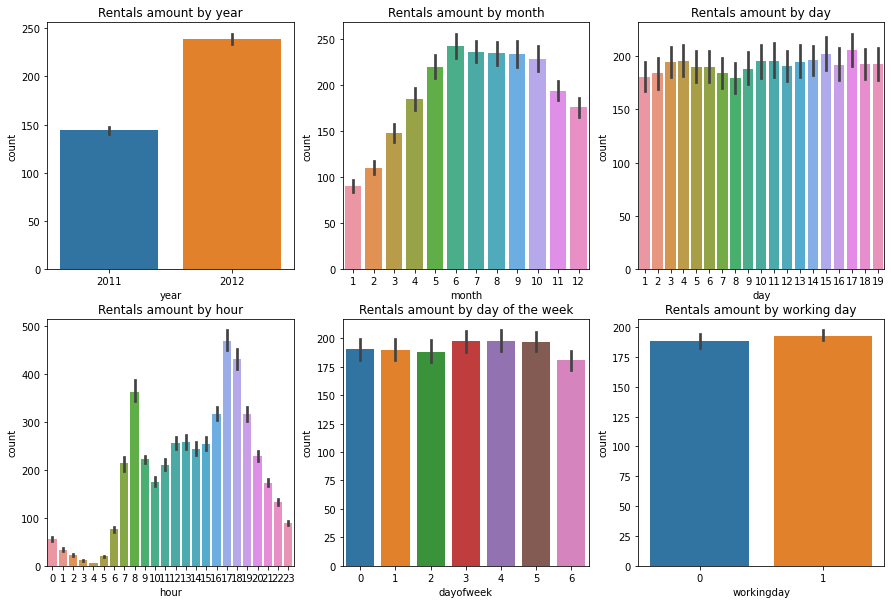

In [23]:
fig, axes = plt.subplots(nrows=2, ncols=3)
fig.set_size_inches(15, 10)

sns.barplot(data=train, x='year', y='count', ax=axes[0][0])
sns.barplot(data=train, x='month', y='count', ax=axes[0][1])
sns.barplot(data=train, x='day', y='count', ax=axes[0][2])
sns.barplot(data=train, x='hour', y='count', ax=axes[1][0])
sns.barplot(data=train, x='dayofweek', y='count', ax=axes[1][1])
sns.barplot(data=train, x='workingday', y='count', ax=axes[1][2])

axes[0][0].set(ylabel='count',title='Rentals amount by year')
axes[0][1].set(ylabel='count',title='Rentals amount by month')
axes[0][2].set(ylabel='count',title='Rentals amount by day')
axes[1][0].set(ylabel='count',title='Rentals amount by hour')
axes[1][1].set(ylabel='count',title='Rentals amount by day of the week')
axes[1][2].set(ylabel='count',title='Rentals amount by working day');

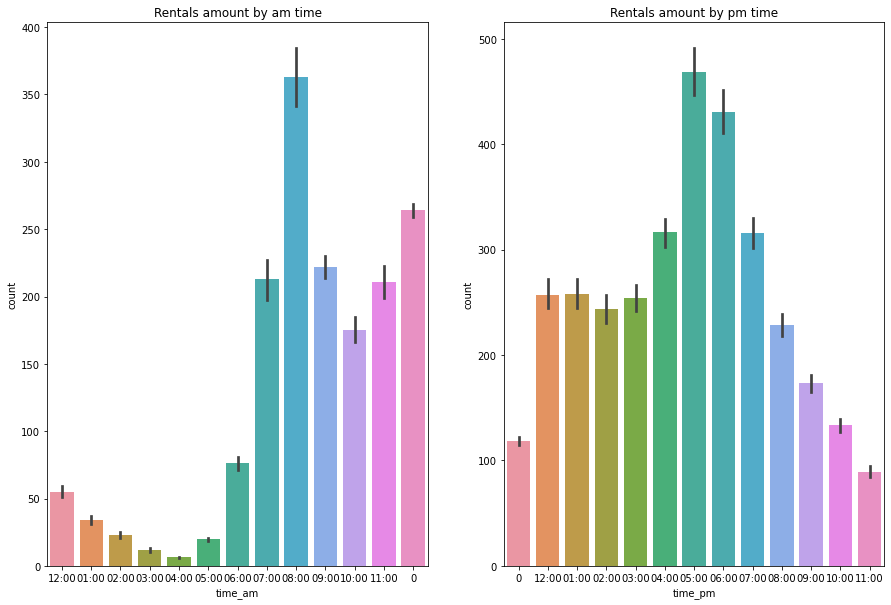

In [24]:
fig, axes = plt.subplots(ncols=2)
fig.set_size_inches(15, 10)

sns.barplot(data=train, x='time_am', y='count', ax=axes[0])
sns.barplot(data=train, x='time_pm', y='count', ax=axes[1])
axes[0].set(ylabel='count', title='Rentals amount by am time');
axes[1].set(ylabel='count', title='Rentals amount by pm time');

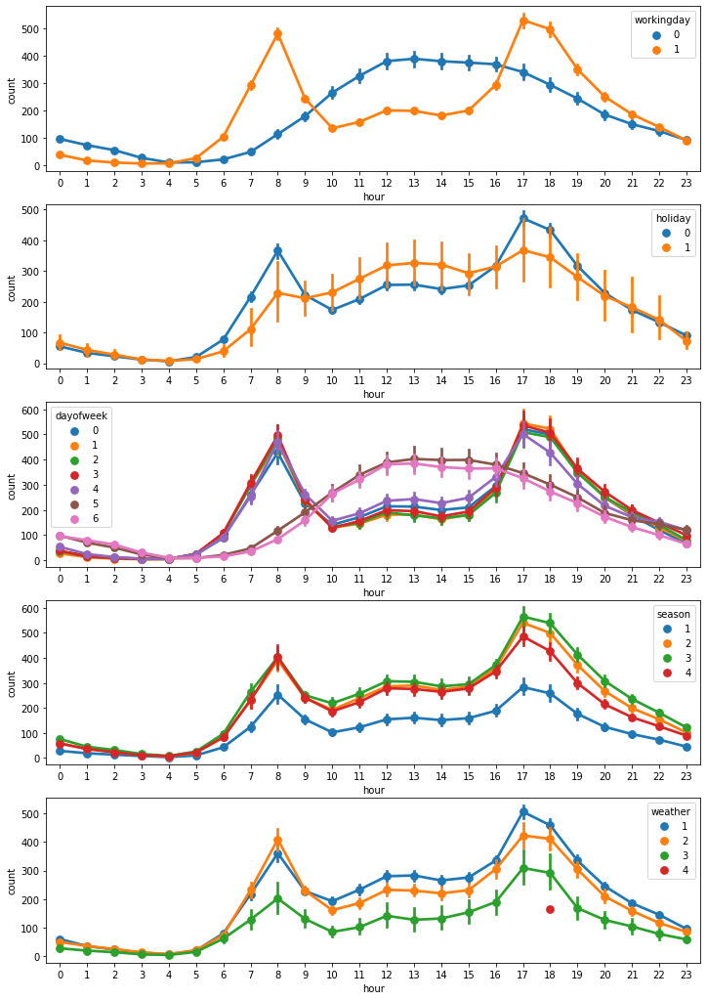

In [25]:
figure, axes = plt.subplots(nrows=5) 
figure.set_size_inches(12, 18)

sns.pointplot(x='hour', y='count', data=train, hue='workingday', ax=axes[0])
sns.pointplot(x='hour', y='count', data=train, hue='holiday', ax=axes[1])
sns.pointplot(x='hour', y='count', data=train, hue='dayofweek', ax=axes[2])
sns.pointplot(x='hour', y='count', data=train, hue='season', ax=axes[3])
sns.pointplot(x='hour', y='count', data=train, hue='weather', ax=axes[4]);

In [26]:
#train.groupby(train[['day']== 5]["count"]).sum().plot.bar()

In [27]:
#train.groupby(['month'])["count"].sum().plot.bar()

## EDA

In [28]:
train['year'].value_counts()

2012    5464
2011    5422
Name: year, dtype: int64

In [29]:
test['year'].value_counts()

2012    3270
2011    3223
Name: year, dtype: int64

In [30]:
#sns.distplot(train['year']);

In [31]:
train['workingday'].value_counts()

1    7412
0    3474
Name: workingday, dtype: int64

In [32]:
test['workingday'].value_counts()

1    4453
0    2040
Name: workingday, dtype: int64

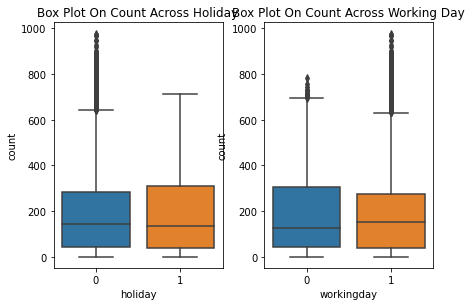

In [33]:
figure, axes = plt.subplots(ncols=2) 
plt.tight_layout()

sns.boxplot(x='holiday', y='count', data=train, ax=axes[0])
sns.boxplot(x='workingday', y='count', data=train, ax=axes[1])

axes[0].set(title='Box Plot On Count Across Holiday')
axes[1].set(title='Box Plot On Count Across Working Day');

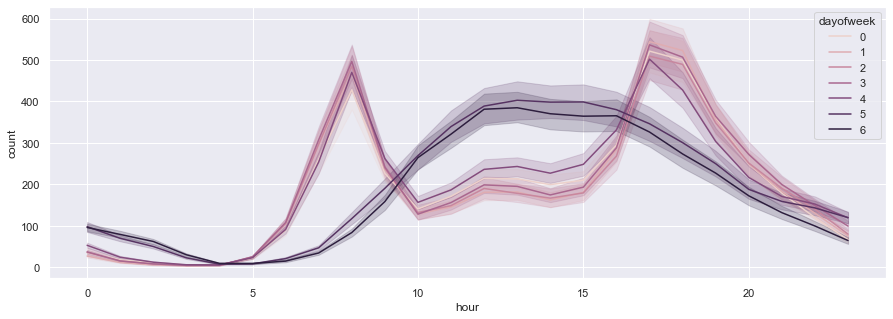

In [34]:
sns.set(rc = {'figure.figsize':(15,5)})
sns.lineplot(data=train,x='hour', y='count',  hue=train['dayofweek']);

<AxesSubplot:>

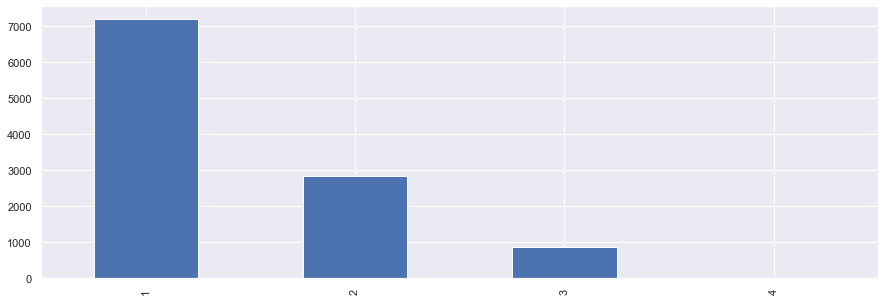

In [35]:
train["weather"].value_counts().plot(kind="bar")

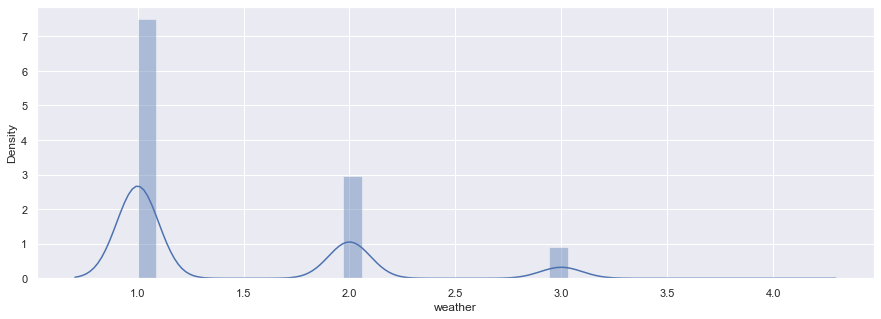

In [36]:
sns.distplot(train["weather"]);

Mean value of temperature is : 20.230859819952173


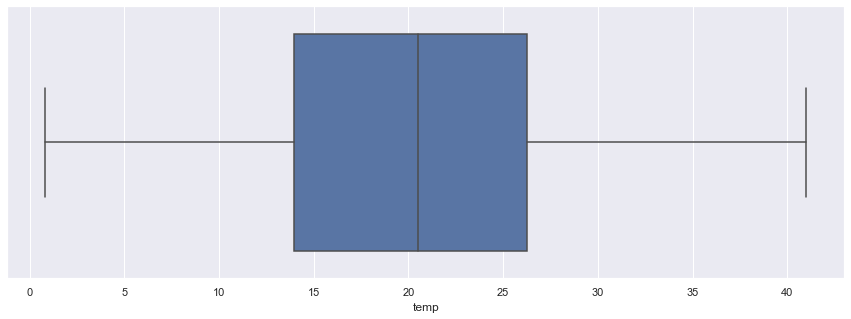

In [37]:
sns.boxplot("temp", data=train)
# checking the mean values
print("Mean value of temperature is :", train.temp.mean())

In [38]:
train.pivot_table(values='temp', index='year', aggfunc=['min', 'mean', 'max'])

,min,mean,max
,temp,temp,temp
year,,,
2011,2.46,19.751988,38.54
2012,0.82,20.706051,41.00


In [39]:
freq_temp_2011 = train[train['year']== 2011]['temp'].mode()[0]
freq_temp_2011

18.86

In [40]:
freq_temp_2012 = train[train['year']== 2012]['temp'].mode()[0]
freq_temp_2012

14.76

In [41]:
#sns.histplot(train['atemp']);

In [42]:
train.pivot_table(values='humidity', index='year', aggfunc=['min', 'mean', 'max'])

,min,mean,max
,humidity,humidity,humidity
year,,,
2011,0,63.405017,100
2012,16,60.379575,100


In [43]:
freq_humidity = train['humidity'].mode()[0]

In [44]:
#sns.histplot(train['humidity']);

In [45]:
#sns.histplot(train['windspeed']);

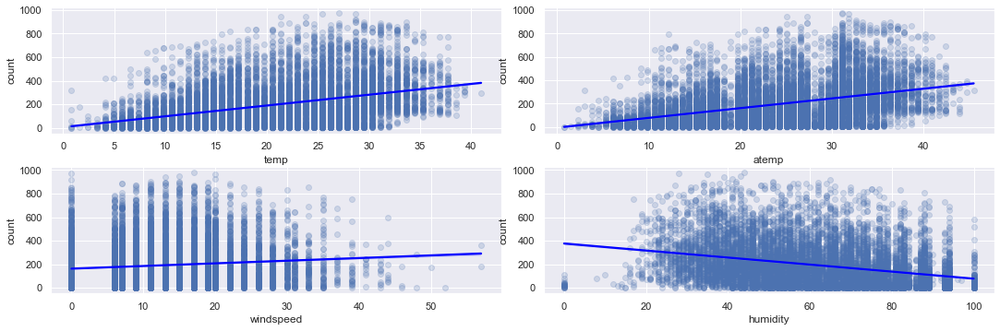

In [46]:
figure, axes = plt.subplots(nrows=2, ncols=2) 
plt.tight_layout()

sns.regplot(x='temp', y='count', data=train, ax=axes[0, 0], 
            scatter_kws={'alpha': 0.2}, line_kws={'color': 'blue'})
sns.regplot(x='atemp', y='count', data=train, ax=axes[0, 1], 
            scatter_kws={'alpha': 0.2}, line_kws={'color': 'blue'})
sns.regplot(x='windspeed', y='count', data=train, ax=axes[1, 0], 
            scatter_kws={'alpha': 0.2}, line_kws={'color': 'blue'})
sns.regplot(x='humidity', y='count', data=train, ax=axes[1, 1], 
            scatter_kws={'alpha': 0.2}, line_kws={'color': 'blue'});

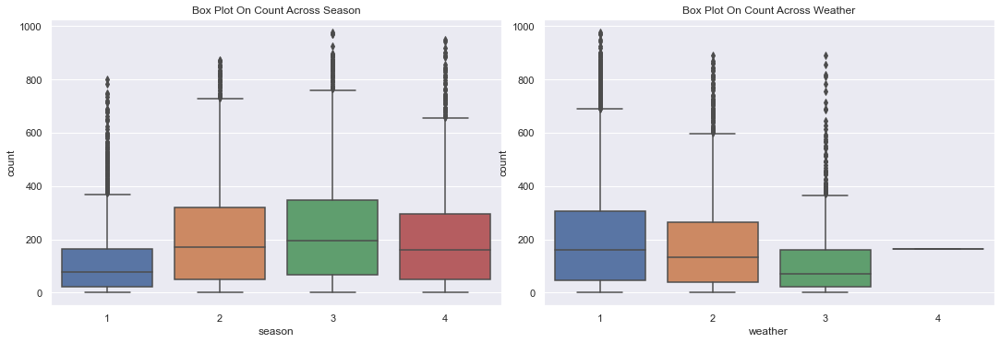

In [47]:
figure, axes = plt.subplots(ncols=2) 
plt.tight_layout()

sns.boxplot(x='season', y='count', data=train, ax=axes[0])
sns.boxplot(x='weather', y='count', data=train, ax=axes[1])

axes[0].set(title='Box Plot On Count Across Season')
axes[1].set(title='Box Plot On Count Across Weather');

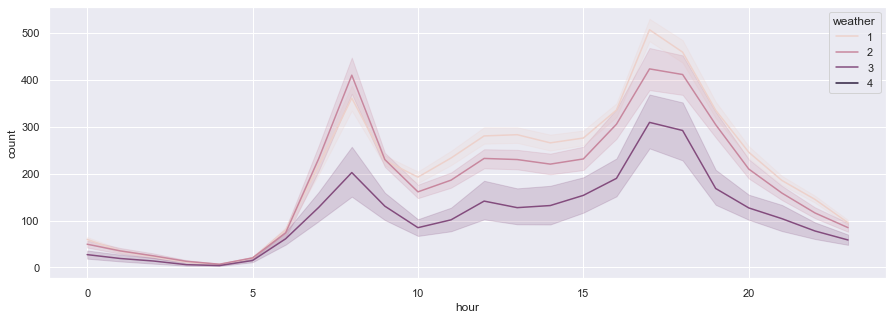

In [48]:
sns.set(rc = {'figure.figsize':(15,5)})
sns.lineplot(data=train,x='hour', y='count',  hue=train['weather']);

## Target

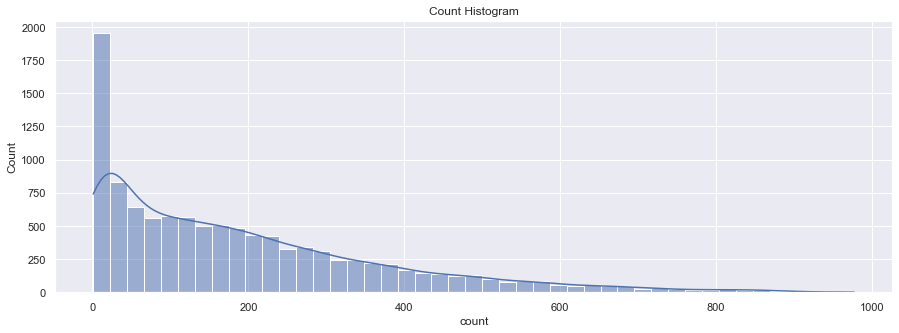

In [49]:
# train_target histogram 
plt.title('Count Histogram')
sns.histplot(train['count'], kde=True)
plt.show()

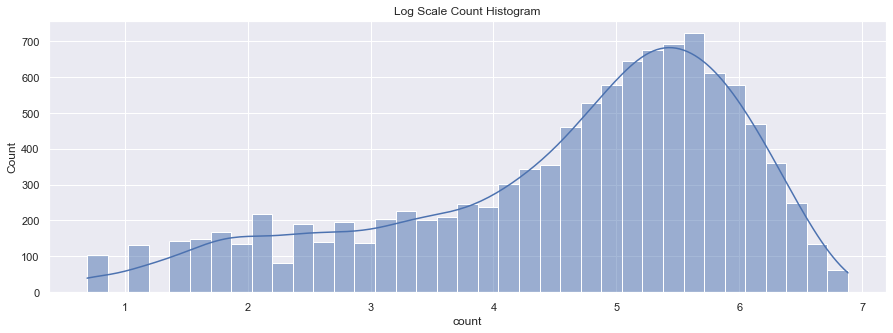

In [50]:
# train_target log transformation
plt.title('Log Scale Count Histogram')
train_target_log = np.log1p(train['count'])
sns.histplot(train_target_log, kde=True)
plt.show()

## Data check

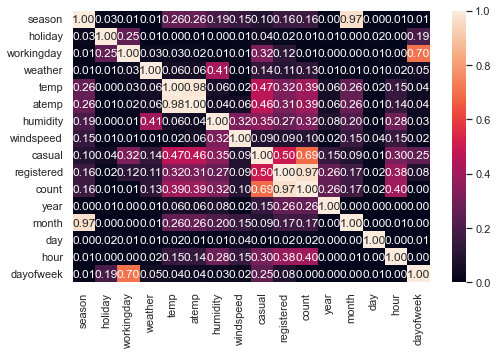

In [51]:
# correlation matrix
plt.figure(figsize=(8, 5))
sns.heatmap(train.corr().abs(), vmin=0, vmax=1, annot=True, fmt=".2f");

## Numeric, categorical, binary features

In [52]:
train['sample'] = 1 # mark where is train
test['sample'] = 0 # mark where is test
test['count'] = 1 # we predict count
# merge the data
data = test.append(train, sort=False).reset_index(drop=True) 

print('Data shape:', data.shape)
data.head(2)

Data shape: (17379, 23)


,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,year,month,day,time,hour,dayofweek,date,time_12hrs,time_am,time_pm,sample,count,casual,registered
0,2011-01-20 00:00:00,1,0,1,1,10.66,11.365,56,26.0027,2011,1,20,00:00:00,0,3,2011-01-20,12:00 AM,12:00,0,0,1,NaN,NaN
1,2011-01-20 01:00:00,1,0,1,1,10.66,13.635,56,0.0000,2011,1,20,01:00:00,1,3,2011-01-20,01:00 AM,01:00,0,0,1,NaN,NaN


In [53]:
data.head(2)

,datetime,season,holiday,workingday,weather,temp,atemp,humidity,windspeed,year,month,day,time,hour,dayofweek,date,time_12hrs,time_am,time_pm,sample,count,casual,registered
0,2011-01-20 00:00:00,1,0,1,1,10.66,11.365,56,26.0027,2011,1,20,00:00:00,0,3,2011-01-20,12:00 AM,12:00,0,0,1,NaN,NaN
1,2011-01-20 01:00:00,1,0,1,1,10.66,13.635,56,0.0000,2011,1,20,01:00:00,1,3,2011-01-20,01:00 AM,01:00,0,0,1,NaN,NaN


In [54]:
data.isnull().sum().sort_values(ascending=False)

registered    6493
casual        6493
time             0
count            0
sample           0
time_pm          0
time_am          0
time_12hrs       0
date             0
dayofweek        0
hour             0
datetime         0
season           0
month            0
year             0
windspeed        0
humidity         0
atemp            0
temp             0
weather          0
workingday       0
holiday          0
day              0
dtype: int64

In [55]:
data['registered'] = data['registered'].fillna(0) 
data['casual'] = data['casual'].fillna(0) 

In [56]:
data.nunique()

datetime      17379
season            4
holiday           2
workingday        2
weather           4
temp             50
atemp            65
humidity         89
windspeed        30
year              2
month            12
day              31
time             24
hour             24
dayofweek         7
date            731
time_12hrs       24
time_am          13
time_pm          13
sample            2
count           822
casual          309
registered      731
dtype: int64

In [57]:
data.columns

Index(['datetime', 'season', 'holiday', 'workingday', 'weather', 'temp',
       'atemp', 'humidity', 'windspeed', 'year', 'month', 'day', 'time',
       'hour', 'dayofweek', 'date', 'time_12hrs', 'time_am', 'time_pm',
       'sample', 'count', 'casual', 'registered'],
      dtype='object')

In [58]:
bin_cols = ['holiday', 'workingday','year',]
cat_cols = ['season','weather', 'month', 'day','hour','dayofweek', ]
num_cols = ['temp', 'atemp','humidity', 'windspeed','casual', 'registered']

Numeric columns

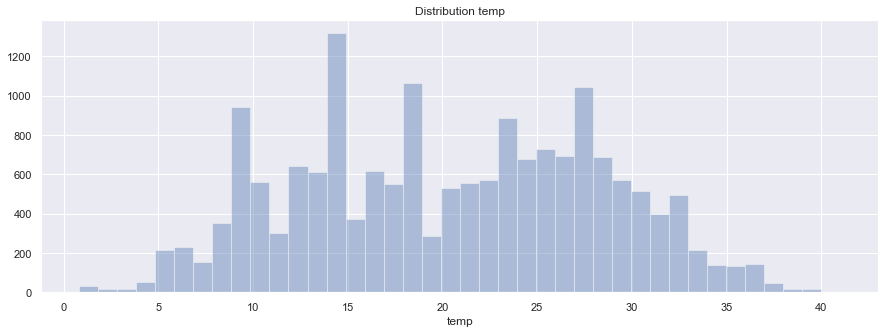

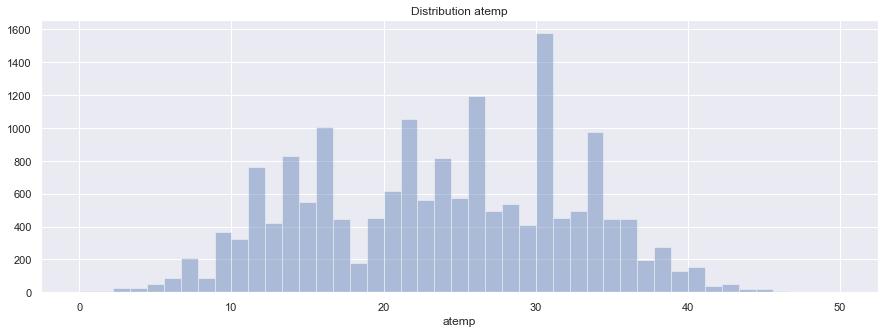

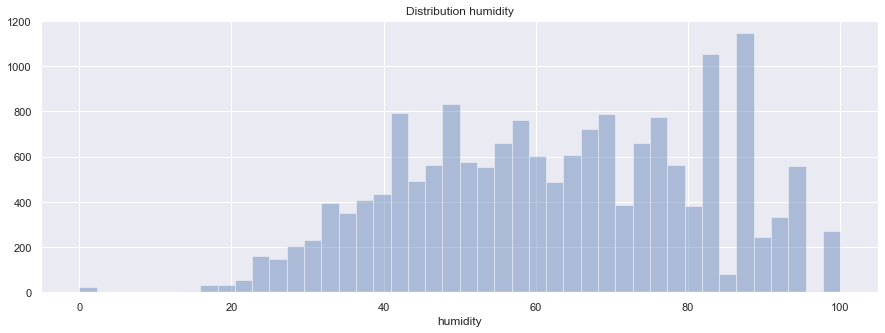

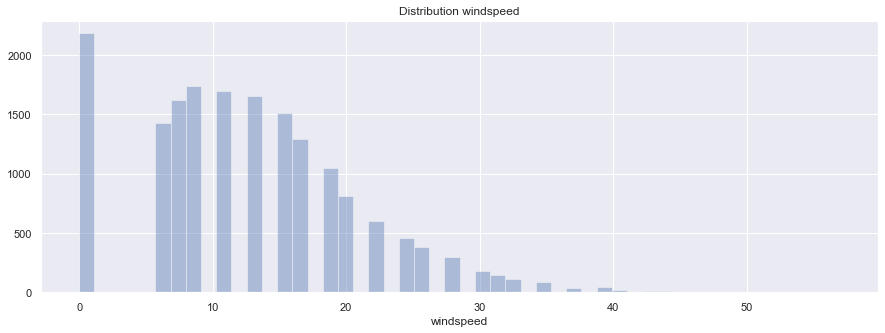

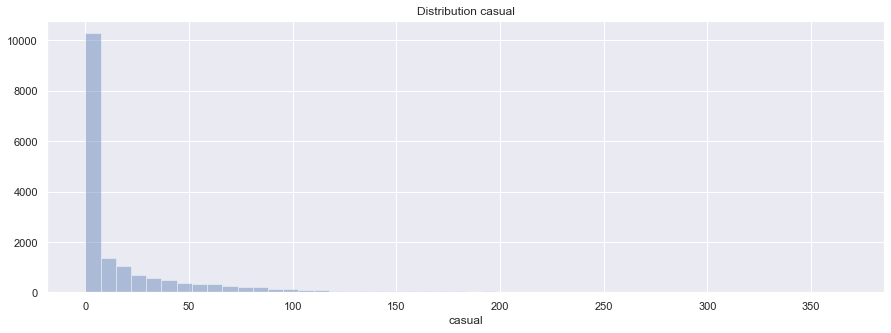

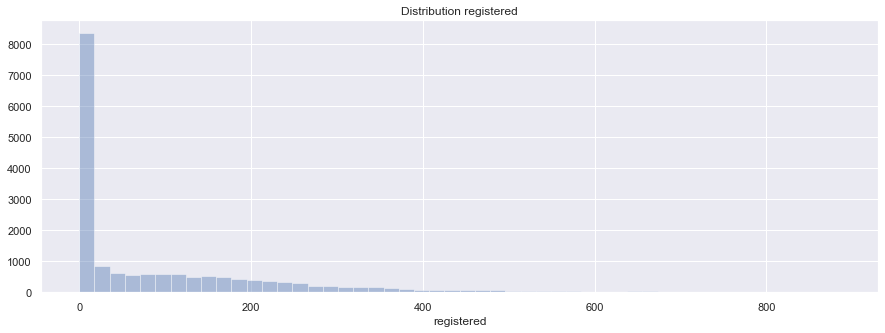

In [59]:
for col in num_cols:
    plt.figure()
    plt.title(f"Distribution {col}")
    sns.distplot(data[col], kde=False)

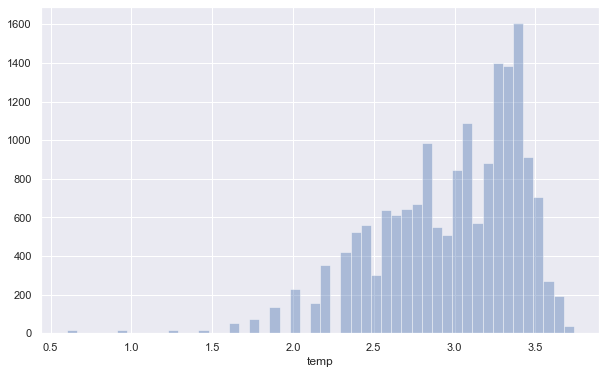

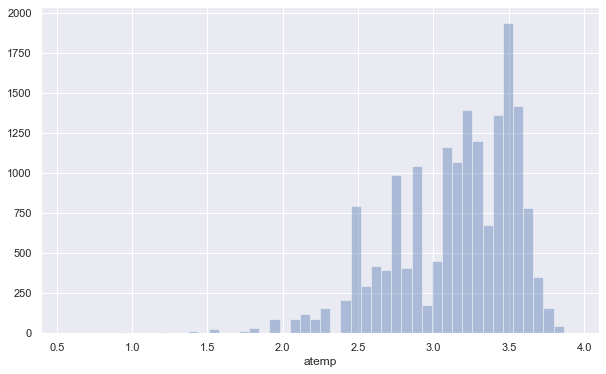

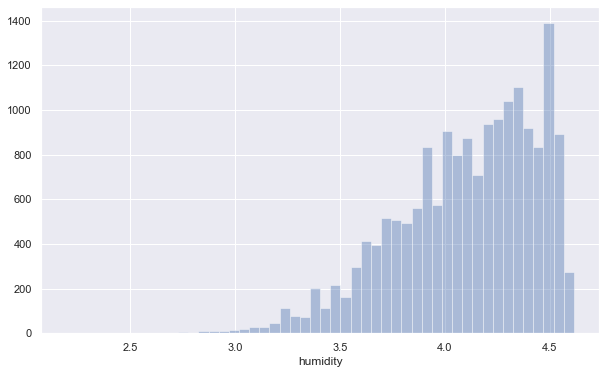

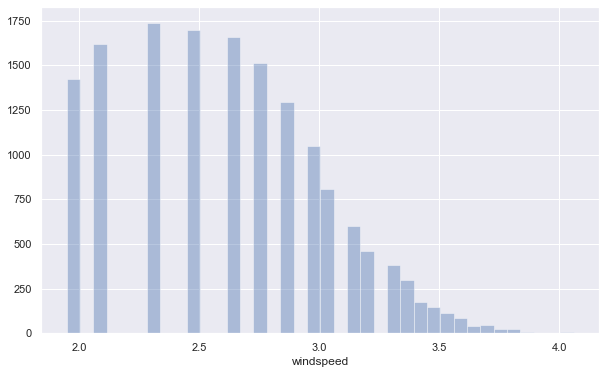

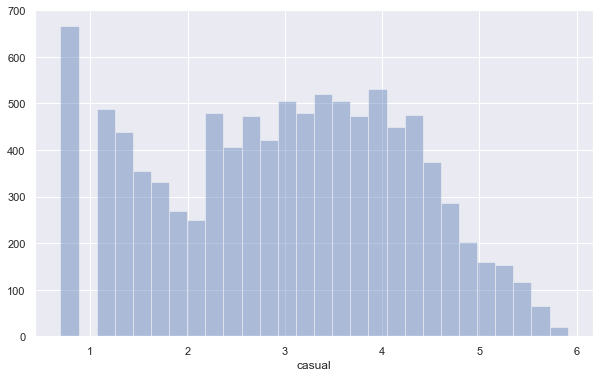

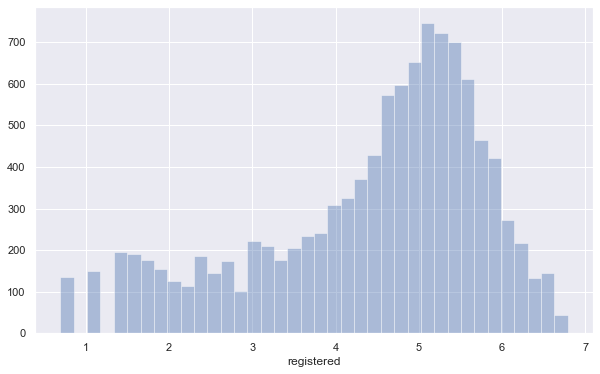

In [60]:
# attempt to normalize the distribution of num_cols
cols_log = ['temp', 'atemp','humidity', 'windspeed','casual', 'registered']
for i in cols_log:
    data[i] = np.log(data[i] + 1)
    plt.figure(figsize=(10,6))
    sns.distplot(data[i][data[i] > 0].dropna(), kde = False, rug=False)
    plt.show()

In [61]:
data[num_cols] = data[num_cols].round(2)

<AxesSubplot:>

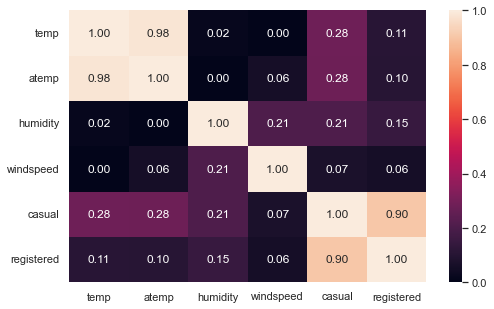

In [62]:
# correlation of features
plt.figure(figsize=(8, 5))
sns.heatmap(data[num_cols].corr().abs(), vmin=0, vmax=1, annot=True, fmt=".2f")

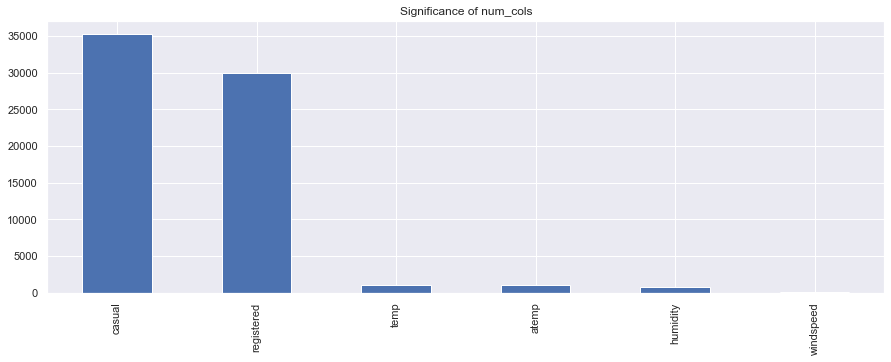

In [63]:
from sklearn.feature_selection import f_regression, mutual_info_regression

# ANOVA analysis
imp_num = pd.Series(f_regression(
    data[num_cols], data["count"])[0], index=num_cols)
imp_num.sort_values(inplace=True, ascending=False)
imp_num.plot(kind="bar")
plt.title('Significance of num_cols');

In [64]:
data = data.drop(['atemp'], axis=1)

In [65]:
data.pivot_table(values='registered', index='year', aggfunc=['min', 'mean', 'max'])

,min,mean,max
,registered,registered,registered
year,,,
2011,0.0,2.590143,6.34
2012,0.0,2.914997,6.79


In [66]:
data.pivot_table(values='casual', index='year', aggfunc=['min', 'mean', 'max'])

,min,mean,max
,casual,casual,casual
year,,,
2011,0.0,1.591041,5.61
2012,0.0,1.805821,5.91


Categorical columns

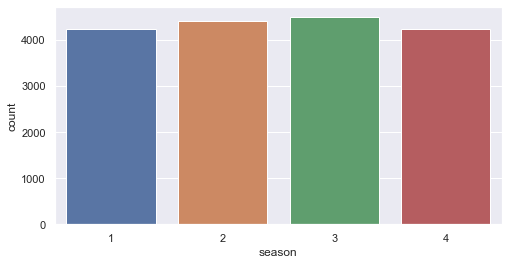

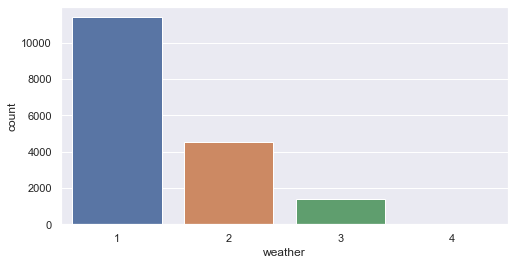

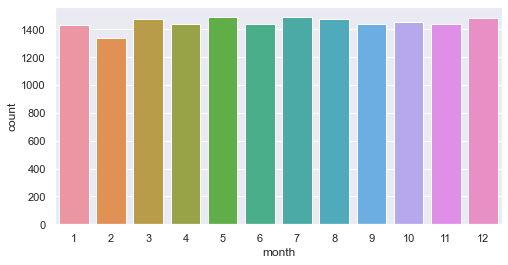

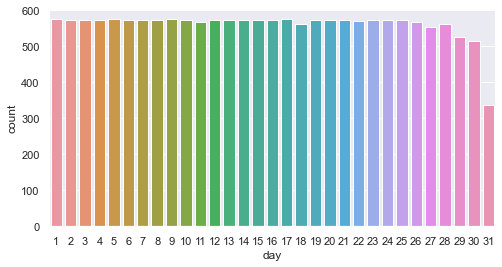

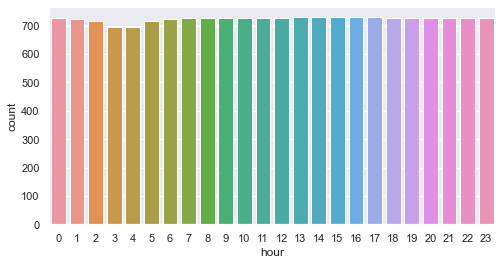

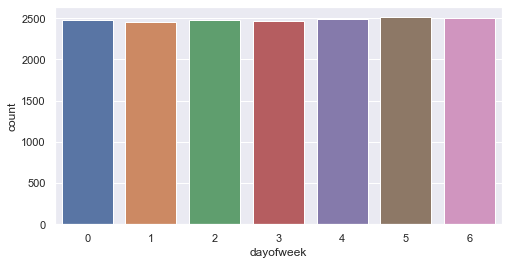

In [67]:
for col in cat_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(data[col])

Text(0.5, 1.0, 'Significance of categorical columns')

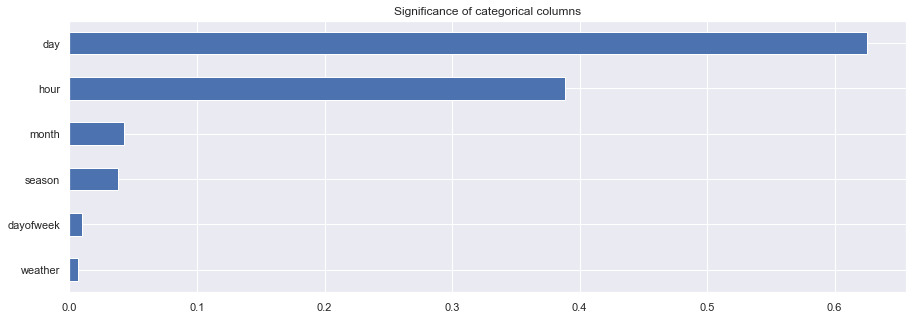

In [68]:
# significance of features
imp_cat = pd.Series(mutual_info_regression(pd.concat([data[cat_cols]], axis=1),
                                           data['count'], discrete_features=True),
                    index=pd.concat([data[cat_cols]], axis=1).columns)
imp_cat.sort_values(inplace=True)
imp_cat.plot(kind='barh')
plt.title('Significance of categorical columns')

<AxesSubplot:>

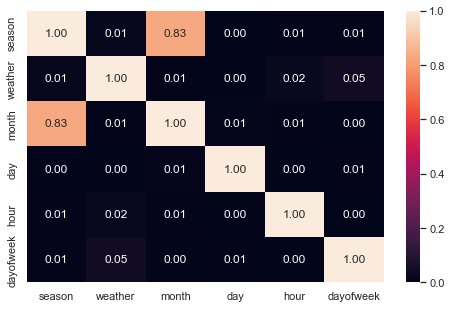

In [69]:
# correlation of features
plt.figure(figsize=(8, 5))
sns.heatmap(data[cat_cols].corr().abs(), vmin=0, vmax=1, annot=True, fmt=".2f")

Binary columns

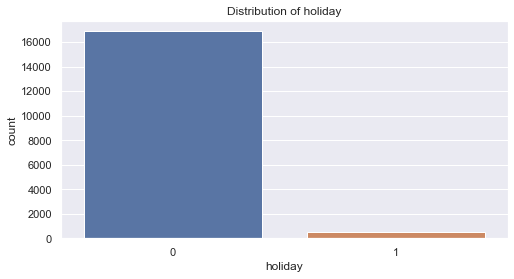

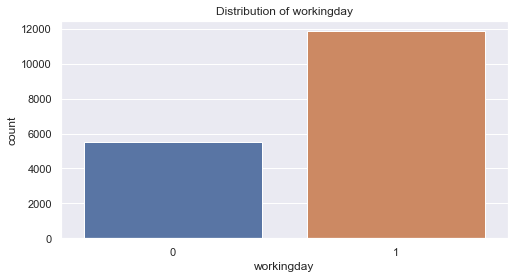

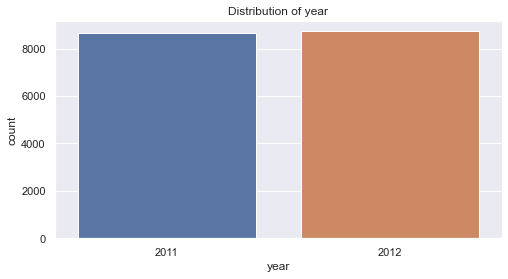

In [70]:
for col in bin_cols:
    plt.figure(figsize=(8, 4))
    sns.countplot(data[col])
    plt.title(f"Distribution of {col}")

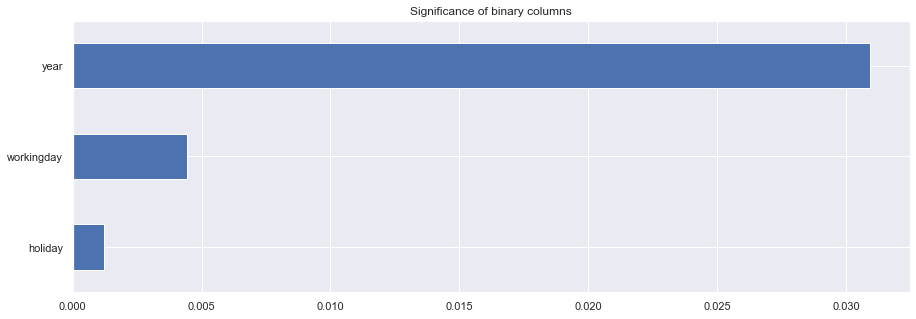

In [71]:
imp_bin = pd.Series(mutual_info_regression(data[bin_cols], data['count'],
                                        discrete_features=True), index=bin_cols)
imp_bin.sort_values(inplace=True)
imp_bin.plot(kind='barh')
plt.title('Significance of binary columns');

## Feature engineering

In [72]:
data.head()

,datetime,season,holiday,workingday,weather,temp,humidity,windspeed,year,month,day,time,hour,dayofweek,date,time_12hrs,time_am,time_pm,sample,count,casual,registered
0,2011-01-20 00:00:00,1,0,1,1,2.46,4.04,3.30,2011,1,20,00:00:00,0,3,2011-01-20,12:00 AM,12:00,0,0,1,0.0,0.0
1,2011-01-20 01:00:00,1,0,1,1,2.46,4.04,0.00,2011,1,20,01:00:00,1,3,2011-01-20,01:00 AM,01:00,0,0,1,0.0,0.0
2,2011-01-20 02:00:00,1,0,1,1,2.46,4.04,0.00,2011,1,20,02:00:00,2,3,2011-01-20,02:00 AM,02:00,0,0,1,0.0,0.0
3,2011-01-20 03:00:00,1,0,1,1,2.46,4.04,2.49,2011,1,20,03:00:00,3,3,2011-01-20,03:00 AM,03:00,0,0,1,0.0,0.0
4,2011-01-20 04:00:00,1,0,1,1,2.46,4.04,2.49,2011,1,20,04:00:00,4,3,2011-01-20,04:00 AM,04:00,0,0,1,0.0,0.0


In [73]:
#data['hour'].value_counts()
#data = pd.DataFrame({'hour':range(1, 25)})

b = [0,4,8,12,16,20,24]
l = ['Late Night', 'Early Morning','Morning','Noon','Eve','Night']
data['day_range'] = pd.cut(data['hour'], bins=b, labels=l, include_lowest=True)

In [74]:
#data['day_range'] = data['day_range'].astype('category').cat.codes
data = pd.get_dummies(data, columns=['day_range'])

In [75]:
data['year'] = data['year'].astype('category').cat.codes

In [76]:
data.head()

,datetime,season,holiday,workingday,weather,temp,humidity,windspeed,year,month,day,time,hour,dayofweek,date,time_12hrs,time_am,time_pm,sample,count,casual,registered,day_range_Late Night,day_range_Early Morning,day_range_Morning,day_range_Noon,day_range_Eve,day_range_Night
0,2011-01-20 00:00:00,1,0,1,1,2.46,4.04,3.30,0,1,20,00:00:00,0,3,2011-01-20,12:00 AM,12:00,0,0,1,0.0,0.0,1,0,0,0,0,0
1,2011-01-20 01:00:00,1,0,1,1,2.46,4.04,0.00,0,1,20,01:00:00,1,3,2011-01-20,01:00 AM,01:00,0,0,1,0.0,0.0,1,0,0,0,0,0
2,2011-01-20 02:00:00,1,0,1,1,2.46,4.04,0.00,0,1,20,02:00:00,2,3,2011-01-20,02:00 AM,02:00,0,0,1,0.0,0.0,1,0,0,0,0,0
3,2011-01-20 03:00:00,1,0,1,1,2.46,4.04,2.49,0,1,20,03:00:00,3,3,2011-01-20,03:00 AM,03:00,0,0,1,0.0,0.0,1,0,0,0,0,0
4,2011-01-20 04:00:00,1,0,1,1,2.46,4.04,2.49,0,1,20,04:00:00,4,3,2011-01-20,04:00 AM,04:00,0,0,1,0.0,0.0,1,0,0,0,0,0


In [77]:
from sklearn.preprocessing import StandardScaler
new_num_cols = ['temp', 'humidity', 'windspeed']
scaler = StandardScaler()

In [78]:
x_num = StandardScaler().fit_transform(data[new_num_cols].values)
x_num = pd.DataFrame(x_num, columns=['temp_sc', 'humidity_sc', 'windspeed_sc'])
x_num.head()

,temp_sc,humidity_sc,windspeed_sc
0,-1.207635,-0.16127,1.015103
1,-1.207635,-0.16127,-2.388319
2,-1.207635,-0.16127,-2.388319
3,-1.207635,-0.16127,0.179717
4,-1.207635,-0.16127,0.179717


In [79]:
data = pd.concat([data, x_num], axis=1)

In [80]:
data = data.drop(['date', 'time_12hrs','time_am', 'time_pm','time'], axis=1)

In [81]:
data.set_index('datetime', inplace=True)

In [82]:
data.head(2)

,season,holiday,workingday,weather,temp,humidity,windspeed,year,month,day,hour,dayofweek,sample,count,casual,registered,day_range_Late Night,day_range_Early Morning,day_range_Morning,day_range_Noon,day_range_Eve,day_range_Night,temp_sc,humidity_sc,windspeed_sc
datetime,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-20 00:00:00,1,0,1,1,2.46,4.04,3.3,0,1,20,0,3,0,1,0.0,0.0,1,0,0,0,0,0,-1.207635,-0.16127,1.015103
2011-01-20 01:00:00,1,0,1,1,2.46,4.04,0.0,0,1,20,1,3,0,1,0.0,0.0,1,0,0,0,0,0,-1.207635,-0.16127,-2.388319


In [83]:
print('Final data set shape:', data.shape)

Final data set shape: (17379, 25)


## Data preparation

In [84]:
# split the data
train_data = data[data['sample'] == 1].drop(['sample'], axis=1)
test_data = data[data['sample'] == 0].drop(['sample'], axis=1)

## LR_1

In [85]:
X = train_data.drop('count', axis=1)
y = train_data['count']

In [86]:
from sklearn.model_selection import train_test_split 

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((7620, 23), (3266, 23), (7620,), (3266,))

In [87]:
X_sub = data.query('sample == 0').drop(['sample'], axis=1)

In [88]:
#model_LR = LinearRegression().fit(X_train, y_train)
#y_pred = model_LR.predict(X_test)
#model_LR.score(X_test, y_test)

In [89]:
y_train_log = np.log(y_train)

In [90]:
from sklearn.linear_model import LinearRegression 

model_LR = LinearRegression().fit(X_train, y_train_log)
# logarithm prediction
y_pred_log = model_LR.predict(X_test)
# exponent prediction
ypred = np.exp(y_pred_log)
ypred

array([128.8746843 ,  12.68843881, 164.34897038, ..., 294.93350103,
       162.44585056,   2.1533054 ])

In [91]:
print(f'm.coef_ = {model_LR.coef_}, m.intercept_ = {model_LR.intercept_}')

m.coef_ = [ 1.28159529e-02 -2.05584928e-02 -5.68404501e-02  5.11092966e-03
  1.38077415e-03 -1.47017882e-04 -2.27189539e-03 -2.60001254e-02
 -5.67912135e-03 -1.51284738e-04 -1.16618960e-02 -2.20070671e-03
  1.51841164e-01  9.37785634e-01 -1.11273395e-01 -3.94774559e-02
 -2.18668885e-02  2.01462409e-02  2.74968934e-02  1.24974605e-01
  3.20712948e-03 -4.02986297e-04 -2.34309610e-03], m.intercept_ = 0.22296042436642427


In [92]:
#plt.plot(X,model_LR.coef_[0]*X+model_LR.intercept_,'-r')

In [93]:
#fig, ax = plt.subplots(figsize=(15, 8))
#ax.scatter(y_train, y_train - ypred)
#ax.axhline(lw=2, color="red")
#plt.show()

In [94]:
#plt.plot(x,residuals,'.')
#plt.axhline(y=residuals.mean(), color='r', linestyle='-')
#plt.xlabel('x')
#plt.ylabel('residuals')

In [95]:
# Root Mean Squared Log Error
def rmsle(y, ypred):  
    log_y = np.log1p(y)
    log_ypred = np.log1p(ypred)
    squared_error = (log_y - log_ypred) ** 2
    rmsle = np.sqrt(np.mean(squared_error))
    return rmsle

def evaluate_regr(y, ypred):
    rmsle_val = rmsle(y, ypred)
    print('RMSLE: {0:.3f}'.format(rmsle_val))

In [96]:
evaluate_regr(y_test, ypred)

RMSLE: 0.100


In [97]:
from sklearn.metrics import mean_squared_error, mean_absolute_error, r2_score


# The coefficient of determination: 1 is perfect prediction f
print('Coefficient of determination: %.3f'
      % r2_score(y_test, ypred))
# The mean squared error 
print('Mean squared error: %.3f'
      % mean_squared_error(y_test, ypred))
# The mean absolute error 
print('Mean absolute error: %.3f'
      % mean_absolute_error(y_test, ypred))

Coefficient of determination: 0.985
Mean squared error: 498.682
Mean absolute error: 12.103


In [98]:
#sns.lmplot(data = train_data, x = 'temp', y = 'count')

### Cross validation

In [99]:
from sklearn.model_selection import cross_validate, cross_val_score

In [100]:
acc_lr = cross_val_score(model_LR, X_train, y_train, \
                      cv=5, scoring='neg_mean_squared_error')
acc_lr

array([-7544.55223167, -8140.51260594, -7311.2869679 , -8178.12994801,
       -7406.84308207])

In [101]:
results = cross_val_score(model_LR, X_train, y_train,cv=5) 
results.mean()

0.7654974395214904

In [102]:
results.std()

0.006833918727942271

## LR_2

In [103]:
train_data.columns

Index(['season', 'holiday', 'workingday', 'weather', 'temp', 'humidity',
       'windspeed', 'year', 'month', 'day', 'hour', 'dayofweek', 'count',
       'casual', 'registered', 'day_range_Late Night',
       'day_range_Early Morning', 'day_range_Morning', 'day_range_Noon',
       'day_range_Eve', 'day_range_Night', 'temp_sc', 'humidity_sc',
       'windspeed_sc'],
      dtype='object')

In [104]:
X = train_data[['season', 'workingday', 'temp', 'humidity', 'year', 'month', 'day', 'hour', 'dayofweek', 'day_range_Late Night',
       'day_range_Early Morning', 'day_range_Morning', 'day_range_Noon',
       'day_range_Eve', 'day_range_Night']]
y = train_data['count']

In [105]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((7620, 15), (3266, 15), (7620,), (3266,))

In [106]:
model_LR2 = LinearRegression().fit(X_train, y_train)
y_pred = model_LR2.predict(X_test)
#model_LR2.score(X_test, y_test)

In [107]:
#model_LR2.score(X_train, y_train)

In [108]:
y_train_log = np.log(y_train)

In [109]:
model_LR2 = LinearRegression().fit(X_train, y_train_log)
# logarithm prediction
y_pred_log = model_LR2.predict(X_test)
# exponent prediction
ypred_lr = np.exp(y_pred_log)
ypred_lr

array([203.13941334,  28.31328041, 216.23012469, ..., 163.19879876,
       158.15446891,   4.07346069])

In [110]:
evaluate_regr(y_test, ypred_lr)

RMSLE: 0.821


### Cross validation

In [111]:
acc_lr = cross_val_score(model_LR2, X_train, y_train, \
                      cv=10, scoring='neg_mean_squared_error')
acc_lr

array([-15015.416423  , -15157.64108673, -16214.12389911, -15069.89357277,
       -15081.3855414 , -16897.17016398, -15524.64915125, -15984.65579246,
       -15313.11056439, -14520.0110005 ])

In [112]:
results = cross_val_score(model_LR2, X_train, y_train,cv=10) 
results.mean()

0.5278805380455461

In [113]:
#evaluate_regr(y_train, ypred_lr)

## Polynomial features

In [114]:
from sklearn import preprocessing

X = train_data[['temp', 'humidity']]
y = train_data['count']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)

poly = preprocessing.PolynomialFeatures(degree=2,include_bias=False)
poly_features = poly.fit_transform(X)

feature_names = poly.get_feature_names_out()


X = pd.DataFrame(poly_features, columns=feature_names)

In [115]:
X = pd.DataFrame(poly_features, columns=feature_names)
y = train_data['count']

X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)

In [116]:
y_train_log = np.log(y_train)

model_LR3 = LinearRegression().fit(X_train, y_train_log)
# logarithm prediction
y_pred_log = model_LR3.predict(X_test)
# exponent prediction
ypred_lr_p = np.exp(y_pred_log)
ypred_lr_p
evaluate_regr(y_test, ypred_lr_p)

RMSLE: 1.213


In [117]:
y_pred_log = model_LR3.predict(X_test)
y_pred_log

array([5.26482443, 2.87514207, 4.13702608, ..., 4.43577686, 5.13822927,
       3.03909529])

In [118]:
model_LR3.score(X_train,y_train_log)

0.25184342023732764

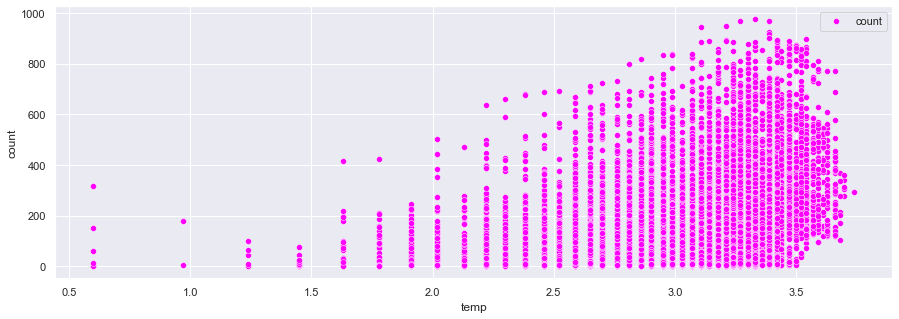

In [119]:
sns.scatterplot(data=train_data, x="temp", y="count", color="magenta", label="count");

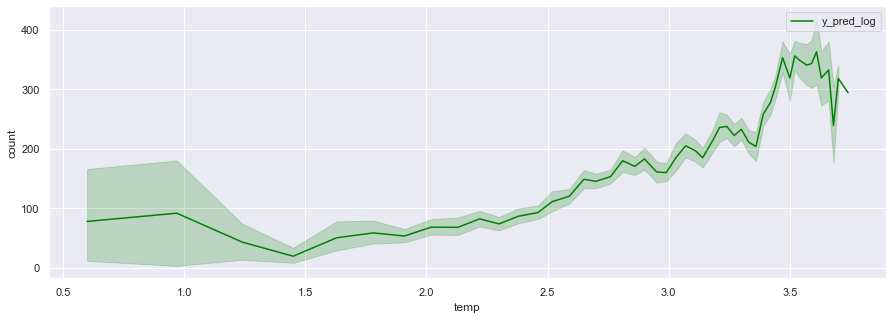

In [120]:
sns.lineplot(data=train_data, x="temp", y="count", color="green", label="y_pred_log");

## RandomForest

In [121]:
X = train_data[['season', 'workingday', 'temp', 'humidity', 'year', 'month', 'hour', 'dayofweek', 'day_range_Late Night',
       'day_range_Early Morning', 'day_range_Morning', 'day_range_Noon',
       'day_range_Eve', 'day_range_Night']]
y = train_data['count']

In [122]:
X_train, X_test, y_train, y_test = train_test_split(X,y, test_size=0.3, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

((7620, 14), (3266, 14), (7620,), (3266,))

In [123]:
from sklearn.ensemble import RandomForestRegressor
model_rf = RandomForestRegressor(n_estimators=200)
model_rf.fit(X_train,y_train)

RandomForestRegressor(n_estimators=200)

In [124]:
print(
    model_rf.score(X_train, y_train).round(2),
    model_rf.score(X_test, y_test).round(2))

0.99 0.94


In [125]:
r2_scores = cross_val_score(model_rf, X_train, y_train, cv=3)
np.average(r2_scores)

0.934605485539817

In [126]:
model_rf_pred = model_rf.predict(X_test)
model_rf_pred

array([129.99 ,  24.835, 148.65 , ..., 206.375, 187.445,   2.07 ])

In [127]:
evaluate_regr(y_test, model_rf_pred)

RMSLE: 0.336


# II. The goal is to build and train a regression model on the Capital Bike Share (Washington, D.C.) data set, in order to predict demand for bicycle rentals at the RAINY WEEKEND IN THE MORNING.

In [128]:
data.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 17379 entries, 2011-01-20 00:00:00 to 2012-12-19 23:00:00
Data columns (total 25 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   season                   17379 non-null  int64  
 1   holiday                  17379 non-null  int64  
 2   workingday               17379 non-null  int64  
 3   weather                  17379 non-null  int64  
 4   temp                     17379 non-null  float64
 5   humidity                 17379 non-null  float64
 6   windspeed                17379 non-null  float64
 7   year                     17379 non-null  int8   
 8   month                    17379 non-null  int64  
 9   day                      17379 non-null  int64  
 10  hour                     17379 non-null  int64  
 11  dayofweek                17379 non-null  int64  
 12  sample                   17379 non-null  int64  
 13  count                    17379 non-null  

In [129]:
data.reset_index(drop=True)

,season,holiday,workingday,weather,temp,humidity,windspeed,year,month,day,hour,dayofweek,sample,count,casual,registered,day_range_Late Night,day_range_Early Morning,day_range_Morning,day_range_Noon,day_range_Eve,day_range_Night,temp_sc,humidity_sc,windspeed_sc
0,1,0,1,1,2.46,4.04,3.30,0,1,20,0,3,0,1,0.00,0.00,1,0,0,0,0,0,-1.207635,-0.161270,1.015103
1,1,0,1,1,2.46,4.04,0.00,0,1,20,1,3,0,1,0.00,0.00,1,0,0,0,0,0,-1.207635,-0.161270,-2.388319
2,1,0,1,1,2.46,4.04,0.00,0,1,20,2,3,0,1,0.00,0.00,1,0,0,0,0,0,-1.207635,-0.161270,-2.388319
3,1,0,1,1,2.46,4.04,2.49,0,1,20,3,3,0,1,0.00,0.00,1,0,0,0,0,0,-1.207635,-0.161270,0.179717
4,1,0,1,1,2.46,4.04,2.49,0,1,20,4,3,0,1,0.00,0.00,1,0,0,0,0,0,-1.207635,-0.161270,0.179717
5,1,0,1,1,2.38,4.11,2.77,0,1,20,5,3,0,1,0.00,0.00,0,1,0,0,0,0,-1.393451,0.030605,0.468493
6,1,0,1,1,2.30,4.11,2.77,0,1,20,6,3,0,1,0.00,0.00,0,1,0,0,0,0,-1.579268,0.030605,0.468493
7,1,0,1,1,2.30,4.03,2.77,0,1,20,7,3,0,1,0.00,0.00,0,1,0,0,0,0,-1.579268,-0.188681,0.468493
8,1,0,1,1,2.30,4.03,3.00,0,1,20,8,3,0,1,0.00,0.00,0,1,0,0,0,0,-1.579268,-0.188681,0.705701
9,1,0,1,2,2.38,3.97,2.77,0,1,20,9,3,0,1,0.00,0.00,0,0,1,0,0,0,-1.393451,-0.353145,0.468493


In [130]:
(data['humidity']==4.62).sum()

270

In [131]:
def fset1(x):
    if x:
        return 1
    else:
        return 0


set1 = (data['workingday'] == 0) & (data['dayofweek'] == 5) & (
    data['dayofweek'] == 6) & (data['holiday'] == 1) & (data['day_range_Morning'] == 1) & (
        data['weather'] == 3) & (data['weather'] == 4.62)
set1

datetime
2011-01-20 00:00:00    False
2011-01-20 01:00:00    False
2011-01-20 02:00:00    False
2011-01-20 03:00:00    False
2011-01-20 04:00:00    False
2011-01-20 05:00:00    False
2011-01-20 06:00:00    False
2011-01-20 07:00:00    False
2011-01-20 08:00:00    False
2011-01-20 09:00:00    False
2011-01-20 10:00:00    False
2011-01-20 11:00:00    False
2011-01-20 12:00:00    False
2011-01-20 13:00:00    False
2011-01-20 14:00:00    False
2011-01-20 15:00:00    False
2011-01-20 16:00:00    False
2011-01-20 17:00:00    False
2011-01-20 18:00:00    False
2011-01-20 19:00:00    False
2011-01-20 20:00:00    False
2011-01-20 21:00:00    False
2011-01-20 22:00:00    False
2011-01-20 23:00:00    False
2011-01-21 00:00:00    False
2011-01-21 01:00:00    False
2011-01-21 02:00:00    False
2011-01-21 03:00:00    False
2011-01-21 04:00:00    False
2011-01-21 05:00:00    False
2011-01-21 06:00:00    False
2011-01-21 07:00:00    False
2011-01-21 08:00:00    False
2011-01-21 09:00:00    False
2011-

In [132]:
data['S1'] = set1.apply(lambda x: fset1(x))
data['S1'].value_counts()

0    17379
Name: S1, dtype: int64

In [133]:
set2 = (data['workingday'] == 0) & (data['day_range_Morning'] == 1) & (
        data['weather'] == 3) & (data['weather'] == 4.62)
set2
data['S2'] = set2.apply(lambda x: fset1(x))
data['S2'].value_counts()

0    17379
Name: S2, dtype: int64

In [134]:
set3 = (data['workingday'] == 0) & (data['weather'] == 3)
set3

datetime
2011-01-20 00:00:00    False
2011-01-20 01:00:00    False
2011-01-20 02:00:00    False
2011-01-20 03:00:00    False
2011-01-20 04:00:00    False
2011-01-20 05:00:00    False
2011-01-20 06:00:00    False
2011-01-20 07:00:00    False
2011-01-20 08:00:00    False
2011-01-20 09:00:00    False
2011-01-20 10:00:00    False
2011-01-20 11:00:00    False
2011-01-20 12:00:00    False
2011-01-20 13:00:00    False
2011-01-20 14:00:00    False
2011-01-20 15:00:00    False
2011-01-20 16:00:00    False
2011-01-20 17:00:00    False
2011-01-20 18:00:00    False
2011-01-20 19:00:00    False
2011-01-20 20:00:00    False
2011-01-20 21:00:00    False
2011-01-20 22:00:00    False
2011-01-20 23:00:00    False
2011-01-21 00:00:00    False
2011-01-21 01:00:00    False
2011-01-21 02:00:00    False
2011-01-21 03:00:00    False
2011-01-21 04:00:00    False
2011-01-21 05:00:00    False
2011-01-21 06:00:00    False
2011-01-21 07:00:00    False
2011-01-21 08:00:00    False
2011-01-21 09:00:00    False
2011-

In [135]:
data['S3'] = set3.apply(lambda x: fset1(x))
data['S3'].value_counts()

0    17000
1      379
Name: S3, dtype: int64

In [136]:
data = data[data['workingday'] == 0]
data

,season,holiday,workingday,weather,temp,humidity,windspeed,year,month,day,hour,dayofweek,sample,count,casual,registered,day_range_Late Night,day_range_Early Morning,day_range_Morning,day_range_Noon,day_range_Eve,day_range_Night,temp_sc,humidity_sc,windspeed_sc,S1,S2,S3
datetime,,,,,,,,,,,,,,,,,,,,,,,,,,,,
2011-01-22 00:00:00,1,0,0,1,0.97,3.83,2.89,0,1,22,0,5,0,1,0.00,0.00,1,0,0,0,0,0,-4.668464,-0.736895,0.592253,0,0,0
2011-01-22 01:00:00,1,0,0,2,0.97,3.74,3.30,0,1,22,1,5,0,1,0.00,0.00,1,0,0,0,0,0,-4.668464,-0.983591,1.015103,0,0,0
2011-01-22 02:00:00,1,0,0,2,0.97,3.74,2.89,0,1,22,2,5,0,1,0.00,0.00,1,0,0,0,0,0,-4.668464,-0.983591,0.592253,0,0,0
2011-01-22 03:00:00,1,0,0,2,0.97,3.74,3.00,0,1,22,3,5,0,1,0.00,0.00,1,0,0,0,0,0,-4.668464,-0.983591,0.705701,0,0,0
2011-01-22 04:00:00,1,0,0,2,0.60,3.89,3.04,0,1,22,4,5,0,1,0.00,0.00,1,0,0,0,0,0,-5.527864,-0.572431,0.746954,0,0,0
2011-01-22 06:00:00,1,0,0,2,0.60,3.81,2.77,0,1,22,6,5,0,1,0.00,0.00,0,1,0,0,0,0,-5.527864,-0.791716,0.468493,0,0,0
2011-01-22 07:00:00,1,0,0,1,0.60,3.81,3.00,0,1,22,7,5,0,1,0.00,0.00,0,1,0,0,0,0,-5.527864,-0.791716,0.705701,0,0,0
2011-01-22 08:00:00,1,0,0,1,0.60,3.81,3.14,0,1,22,8,5,0,1,0.00,0.00,0,1,0,0,0,0,-5.527864,-0.791716,0.850088,0,0,0
2011-01-22 09:00:00,1,0,0,1,0.97,3.74,2.89,0,1,22,9,5,0,1,0.00,0.00,0,0,1,0,0,0,-4.668464,-0.983591,0.592253,0,0,0


In [137]:
data.info()
data.shape

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 5514 entries, 2011-01-22 00:00:00 to 2012-12-16 23:00:00
Data columns (total 28 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   season                   5514 non-null   int64  
 1   holiday                  5514 non-null   int64  
 2   workingday               5514 non-null   int64  
 3   weather                  5514 non-null   int64  
 4   temp                     5514 non-null   float64
 5   humidity                 5514 non-null   float64
 6   windspeed                5514 non-null   float64
 7   year                     5514 non-null   int8   
 8   month                    5514 non-null   int64  
 9   day                      5514 non-null   int64  
 10  hour                     5514 non-null   int64  
 11  dayofweek                5514 non-null   int64  
 12  sample                   5514 non-null   int64  
 13  count                    5514 non-null   i

(5514, 28)

In [138]:
# split the data
train_data = data[data['sample'] == 1].drop(['sample'], axis=1)
test_data = data[data['sample'] == 0].drop(['sample'], axis=1)

In [139]:
X = train_data.drop(['count'], axis=1).values
y = train_data['count'].values

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)
X_train.shape, X_test.shape, y_train.shape, y_test.shape

model_LR2 = LinearRegression().fit(X_train, y_train)
y_pred = model_LR2.predict(X_test)
print(
    model_LR2.score(X_train, y_train).round(2),
    model_LR2.score(X_test, y_test).round(2))

0.84 0.82


In [140]:
y_train_log = np.log(y_train)
model_LR2 = LinearRegression().fit(X_train, y_train_log)
# logarithm prediction
y_pred_log = model_LR2.predict(X_test)
# exponent prediction
ypred_lr = np.exp(y_pred_log)
ypred_lr

array([ 72.18914746,   8.58581307,  93.21416654, ...,  22.72260302,
       490.21952737, 535.00783881])

In [141]:
model_LR2.score(X_train, y_train_log).round(2)

0.99

In [142]:
evaluate_regr(y_test, ypred_lr)

RMSLE: 0.083


In [143]:
results = cross_val_score(model_LR2, X_train, y_train_log, cv=10)
results.mean()

0.9946199716853327

In [144]:
lr2_pred = model_LR2.predict(X_test)
lr2_pred

array([4.27928972, 2.1501112 , 4.53489971, ..., 3.12336016, 6.19485331,
       6.2822814 ])

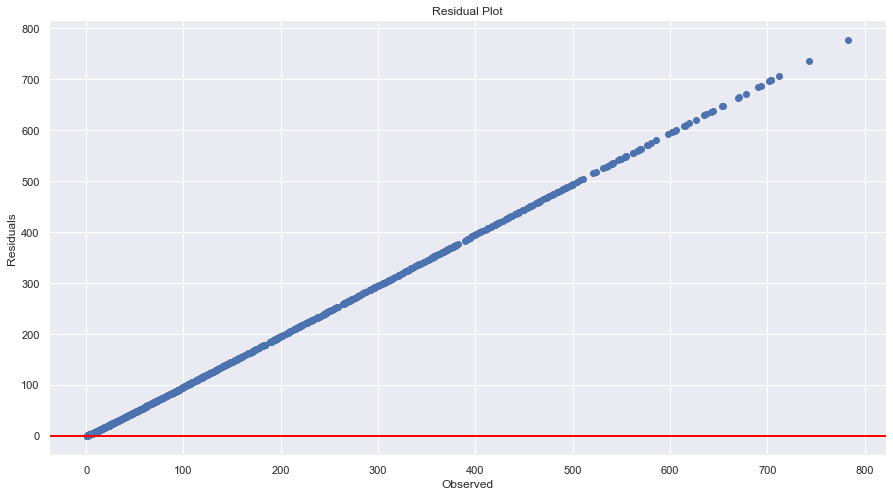

In [145]:
# residual plot
fig, ax = plt.subplots(figsize=(15, 8))
ax.scatter(y_test, y_test - lr2_pred)
ax.axhline(lw=2, color='red')
ax.set_xlabel('Observed')
ax.set_ylabel('Residuals')
ax.title.set_text("Residual Plot")
plt.show()

In [ ]:
sample_submission['count'] = np.exp(model_LR2.predict(X_sub))
submission.to_csv('submission_not_workind_day.csv', index=False)